# Effect of vehicles population renewal on NOx concentrations: STAN implementation

This code aims to implement a code in STAN and Python to get similar results and reliability to the CausalImpact pack in R.

## Model
The model in interest is an AR(1), with gaussian Kernel and
$$
y_t (s_i) = \rho y_{t-1} (s_i) + x_t (s_i)' \beta + w_i + \epsilon_t(s_i)
$$

where:

$$
w \sim \mathcal{N}(0, \Sigma_w), \quad \Sigma_w[i,j] = \exp\left( -\frac{|| s_i - s_j ||^2}{2\rho_w^2} \right)
$$
(Gaussian Process with a Gaussian kernel)

$$
\rho \sim \mathcal{N}(0,1), \quad \beta \sim \mathcal{N}(0, I), \rho\_ω \sim \mathcal{N}(0,1),
$$
(Standard marginal prior)

$$
\epsilon_t(s_i) \sim \mathcal{N}(0, \sigma^2) \quad \text{i.i.d.,} \quad \sigma^2 \sim \text{InvGamma}(a,b)
$$

for every week from $2018/01/01$ to $2024/01/01$, i.e. $t = [1:309]$ and number of stations $N = 83$.
\
Our intervention date was choosen to be considered on week $160$, i.e. $2021-01-25$.

In [ ]:
import sys
import os
import arviz as az
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Stan
import cmdstanpy
#cmdstanpy.install_cmdstan()
from cmdstanpy import CmdStanModel


#from tensorflow_probability.substrates import numpy as tfp
#tfd = tfp.distributions

# Libraries for the map
from pyproj import Proj, transform
import folium
from matplotlib import colors

In [ ]:
df = pd.read_excel('output_file.xlsx')
df = df.sort_values(by=['sensor_id', 'Settimana'])
stations = pd.read_excel('weeklydataset2.xlsx')
df.head(15)

,Utm_Nord,sensor_id,Settimana,temperature_2m_mean,precipitation_sum,precipitation_hours,sunshine_duration,daylight_duration,wind_speed_10m_max,et0_fao_evapotranspiration,Valore,Comune,UTM_Est,lat,lng,TIPO_EOI
42,5040815,6204.0,2018-01-01,4.349143,1.200000,4.428571,15800.095857,31793.244857,13.754136,0.570685,87.998240,Treviglio,546236.0,45.519335,9.592019,UT
127,5040815,6204.0,2018-01-08,6.174143,2.742857,5.142857,18293.086429,32365.938000,15.510893,0.640740,90.695833,Treviglio,546236.0,45.519335,9.592019,UT
212,5040815,6204.0,2018-01-15,3.150036,0.457143,1.857143,27187.993857,33135.910143,12.865133,0.862840,103.585714,Treviglio,546236.0,45.519335,9.592019,UT
297,5040815,6204.0,2018-01-22,4.564321,0.357143,2.285714,18821.623857,34049.212429,10.050846,0.694678,120.221429,Treviglio,546236.0,45.519335,9.592019,UT
382,5040815,6204.0,2018-01-29,5.357476,1.300000,5.714286,11508.773200,35105.069571,9.986021,0.616823,87.173810,Treviglio,546236.0,45.519335,9.592019,UT
467,5040815,6204.0,2018-02-05,4.361940,3.228571,9.857143,18788.814671,36267.440714,8.740718,0.779298,74.726190,Treviglio,546236.0,45.519335,9.592019,UT
552,5040815,6204.0,2018-02-12,2.867893,0.514286,2.285714,26267.873571,37483.383286,8.654310,1.035419,95.497917,Treviglio,546236.0,45.519335,9.592019,UT
637,5040815,6204.0,2018-02-19,3.398250,2.342857,8.428571,15849.423614,38766.954286,13.915153,1.002554,42.001667,Treviglio,546236.0,45.519335,9.592019,UT
722,5040815,6204.0,2018-02-26,-1.352643,3.042857,6.571429,16521.763657,40089.055286,10.869070,0.848068,54.758333,Treviglio,546236.0,45.519335,9.592019,UT
807,5040815,6204.0,2018-03-05,6.578309,6.828572,9.428571,12548.363886,41415.873429,11.883127,0.963814,62.140476,Treviglio,546236.0,45.519335,9.592019,UT


In [ ]:
id = df['sensor_id']
N = len(np.unique(id))
weeks = df['Settimana']
T = len(np.unique(weeks))

In [ ]:
coords = df[['UTM_Est','Utm_Nord']].drop_duplicates()
stats = stations[['sensor_id']].drop_duplicates()

df = pd.merge(df,stats,on='sensor_id')
coords = df[['UTM_Est','Utm_Nord']].drop_duplicates()

coords = coords[~coords['UTM_Est'].isin([598141, 594556])]


for i in df[df['Valore'].isna()].index:
    if df.at[i,'sensor_id']==df.at[i-1,'sensor_id']:
        df.at[i,'Valore']= df.at[i-1,'Valore']

df = df[~df['sensor_id'].isin([20489, 20493])]

df = df[df['Settimana'] >= '2018-02-05']


In [ ]:
y = df.pivot_table(index='sensor_id', columns='Settimana', values='Valore')

# Normalization z-score NOx quantities
y_normalized = np.zeros_like(y.values)
for i in range(y.shape[0]):
    y_mean = y.iloc[i, :].mean()
    y_std = y.iloc[i, :].std()
    y_normalized[i, :] = (y.iloc[i, :] - y_mean) / y_std

y_normalized = pd.DataFrame(y_normalized, index=y.index, columns=y.columns)

# Covariate Selection
covariate_list = ["temperature_2m_mean", "daylight_duration", "precipitation_sum", "et0_fao_evapotranspiration", "precipitation_hours", "sunshine_duration", "wind_speed_10m_max"]
df_covariate = df[covariate_list]

#Covariate selection
x = []
for covariata in covariate_list:
    matrice_2d = df.pivot_table(index='sensor_id', columns='Settimana', values=covariata)
    x.append(matrice_2d.values)
x = np.array(x)
x = x.transpose(1, 2, 0)

# Normalization of covariates
x_normalized = np.zeros_like(x)
for i in range(x.shape[0]):
    for p in range(x.shape[2]):
        x_mean = x[i, :, p].mean()
        x_std = x[i, :, p].std()
        x_normalized[i, :, p] = (x[i, :, p] - x_mean) / x_std

temperature = df.pivot_table(index='sensor_id', columns='Settimana', values='temperature_2m_mean')


# STAN MODEL
In the following section the implementation of the stan code is found.

In [ ]:
import cmdstanpy
causal_code = """

data {
  int<lower=1> N;             // Number of Stations
  int<lower=1> T;             // Time step (in weeks)
  int<lower=1> P;             // Number of covariates
  int<lower=1> T0;            // Intervention Time Step
  matrix[N, 2] coords;        // Coordinates in UTM
  matrix[N, T] y_obs;         // Concentrations of NH
  array[N, T] vector[P] x;    // Tridimensional array of covariates
  real<lower=0> a;            // Parameter for Inv_Gamma
  real<lower=0> b;            // Parameter for Inv_Gamma

}

parameters {
  real<lower=0> rho_w;        // Spatial coeficient for distances
  real<lower=0> sigma;        // Standard deviation of noise
  real rho;                   // Autoregressive coeficient
  vector[P] beta;             // Coeficients for covariates
  vector[N] w;                // Spatial effects
}

transformed parameters {
  cov_matrix[N] Sigma_w;      // Spatial covariance Matrix
  for (i in 1:N) {
    for (j in 1:N) {
      Sigma_w[i, j] = exp(-squared_distance(coords[i], coords[j]) / (2 * rho_w^2));
    }
  }
}

model {

  // Priors
  rho ~ normal(0, 1);                             // Prior for autoregrssive coeficient
  beta ~ normal(0, 1);                            // Prior for covariates coeficients
  sigma ~ inv_gamma(a, b);                        // Prior for standard deviation of noise
  rho_w ~ normal(5000, 500) T[0,];         // Prior for spatial coeficient
  w ~ multi_normal(rep_vector(0, N), Sigma_w);    // Prior for spatial effects

  // Likelihood: Pre-intervention period
  for (t in 2:T0) {
    vector[N] covariate_effect;
    for (i in 1:N) {
      covariate_effect[i] = dot_product(x[i, t], beta);  // Effetto delle covariate
    }
    y_obs[, t] ~ normal(rho * y_obs[, t - 1] + covariate_effect + w, sigma);
  }
}
generated quantities {
  matrix[N, T - T0] y_sim;            // Simulated predictions
  matrix[N, T - T0] impact;           // Pointwise Impact
  vector[T - T0] cumulative_impact;   // Cumulative Impact on all stations

  // For loop for pointwise impact
  for (i in 1:N) {
    for (t in 1:(T - T0)) {
      real covariate_effect = dot_product(x[i, T0 + t], beta);

      if (t == 1) {
        y_sim[i, t] = normal_rng(rho * y_obs[i, T0] + covariate_effect + w[i], sigma);
      } else {
        y_sim[i, t] = normal_rng(rho * y_sim[i, t - 1] + covariate_effect + w[i], sigma);
      }

      // Computation of pointwise impact
      impact[i, t] = y_obs[i, T0 + t] - y_sim[i, t];
    }
  }

  //  Computation of total impact among all stations
  for (t in 1:(T - T0)) {
    cumulative_impact[t] = sum(impact[, 1:t]);
  }
}


"""


# Save the Stan code to a .stan file
causal_file = "causal.stan"
with open(causal_file, "w") as f:
    print(causal_code, file=f)

# Compile Stan model
causal = cmdstanpy.CmdStanModel(stan_file=causal_file)

16:26:50 - cmdstanpy - INFO - compiling stan file C:\Users\david\causal.stan to exe file C:\Users\david\causal.exe
16:27:22 - cmdstanpy - INFO - compiled model executable: C:\Users\david\causal.exe


In [ ]:

from cmdstanpy import CmdStanModel
import numpy as np


N= 83              # Number of stations
T= 309             # Number of total weeks
T0 = 160           # Number of selected week
P = 7              # Number of covariats
a = 0.1            # First Gamma Parameter
b= 0.1             # Second Gamma Parameter

# Stan data
stan_data = {
    'N': N,
    'T': T,
    'P': P,
    'T0': T0,
    'coords': coords,
    'y_obs': y_normalized,
    'x': x_normalized,
    'a': a,
    'b': b
}

# Model fit
model = CmdStanModel(stan_file="causal.stan")
fit = model.sample(data=stan_data, iter_sampling=800, iter_warmup=1000, chains=2, parallel_chains=2, show_console=True)

# Results analysis
posterior = fit.draws_pd()

# Estraction of Simulated and impacts
simulated = posterior.filter(like='y_sim')
impact = posterior.filter(like='impact')
cumulative_impact = posterior.filter(like='cumulative_impact')

print(simulated.mean(axis=0))          # Simulated impact
print(impact.mean(axis=0))             # Punctual impact
print(cumulative_impact.mean(axis=0))  # Comulative impact

16:29:51 - cmdstanpy - INFO - Chain [1] start processing
16:29:51 - cmdstanpy - INFO - Chain [2] start processing


Chain [1] method = sample (Default)Chain [2] method = sample (Default)
Chain [2] sample
Chain [2] num_samples = 800
Chain [2] num_warmup = 1000 (Default)
Chain [2] save_warmup = false (Default)
Chain [2] thin = 1 (Default)

Chain [1] sample
Chain [1] num_samples = 800
Chain [1] num_warmup = 1000 (Default)
Chain [1] save_warmup = false (Default)
Chain [1] thin = 1 (Default)
Chain [1] adapt
Chain [1] engaged = true (Default)
Chain [1] gamma = 0.05 (Default)
Chain [1] delta = 0.8 (Default)
Chain [1] kappa = 0.75 (Default)
Chain [1] t0 = 10 (Default)
Chain [1] init_buffer = 75 (Default)
Chain [1] term_buffer = 50 (Default)
Chain [1] window = 25 (Default)
Chain [1] save_metric = false (Default)
Chain [1] algorithm = hmc (Default)
Chain [1] hmc
Chain [1] engine = nuts (Default)
Chain [1] nuts
Chain [1] max_depth = 10 (Default)
Chain [1] metric = diag_e (Default)
Chain [1] metric_file =  (Default)
Chain [1] stepsize = 1 (Default)
Chain [1] stepsize_jitter = 0 (Default)
Chain [1] num_chains = 

16:38:28 - cmdstanpy - INFO - Chain [2] done processing


Chain [2] 
Chain [2] Elapsed Time: 279.375 seconds (Warm-up)
Chain [2] 237.527 seconds (Sampling)
Chain [2] 516.902 seconds (Total)
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [1] Iteration: 1700 / 1800 [ 94%]  (Sampling)
Chain [1] Iteration: 1800 / 1800 [100%]  (Sampling)


16:39:10 - cmdstanpy - INFO - Chain [1] done processing
16:39:10 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: causal_model_namespace::log_prob: Sigma_w is not positive definite. (in 'causal.stan', line 25, column 2 to column 24)
	Exception: causal_model_namespace::log_prob: Sigma_w is not positive definite. (in 'causal.stan', line 25, column 2 to column 24)
Exception: causal_model_namespace::log_prob: Sigma_w is not positive definite. (in 'causal.stan', line 25, column 2 to column 24)


Chain [1] 
Chain [1] Elapsed Time: 328.661 seconds (Warm-up)
Chain [1] 230.132 seconds (Sampling)
Chain [1] 558.793 seconds (Total)
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
y_sim[1,1]       0.883891
y_sim[2,1]       0.823233
y_sim[3,1]       0.431289
y_sim[4,1]       0.707618
y_sim[5,1]       0.613887
                   ...   
y_sim[79,149]    1.501026
y_sim[80,149]    1.743145
y_sim[81,149]    1.180856
y_sim[82,149]    1.107328
y_sim[83,149]    1.543688
Length: 12367, dtype: float64
impact[1,1]                 -0.608018
impact[2,1]                 -0.469635
impact[3,1]                 -0.455644
impact[4,1]                 -0.553618
impact[5,1]                 -0.422288
                             ...     
cumul

In [ ]:
# fit posterior
posterior = fit.draws_pd()

print(posterior.head())

# search NaN
print(posterior.isna().sum())
print(posterior.nunique())


   chain__  iter__  draw__     lp__  accept_stat__  stepsize__  treedepth__  \
0      1.0     1.0     1.0  3000.55       0.805703    0.119736          5.0   
1      1.0     2.0     2.0  3016.43       0.984569    0.119736          5.0   
2      1.0     3.0     3.0  3009.16       0.619890    0.119736          5.0   
3      1.0     4.0     4.0  3007.73       0.876039    0.119736          5.0   
4      1.0     5.0     5.0  3016.89       0.897003    0.119736          5.0   

   n_leapfrog__  divergent__  energy__  ...  cumulative_impact[140]  \
0          31.0          0.0  -2950.07  ...                -2794.46   
1          31.0          0.0  -2953.58  ...                -2655.78   
2          31.0          0.0  -2965.78  ...                -2929.04   
3          31.0          0.0  -2954.94  ...                -2678.79   
4          31.0          0.0  -2964.78  ...                -2940.24   

   cumulative_impact[141]  cumulative_impact[142]  cumulative_impact[143]  \
0                -282

#Posterior Analysis and Convergence Diagnostics of the Bayesian Causal Model

In this section, we analyze the posterior distributions of the model parameters estimated using Stan, ensuring that the Markov Chain Monte Carlo (MCMC) sampling has properly converged.

## Chain Convergengence
The following code generate the plot to check convergence of the chains for the parameter ρ:

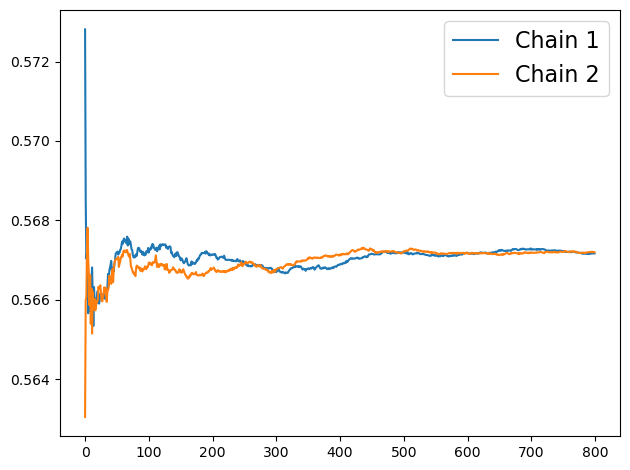

In [ ]:
#Computations of chain
posterior_rho = fit.draws(concat_chains=False)[:, :, fit.column_names.index('rho')]
running_sum = np.cumsum(posterior_rho, axis=0)
running_avg = running_sum / np.arange(1, running_sum.shape[0] + 1)[:, np.newaxis]

for i in range(running_avg.shape[1]):
    plt.plot(running_avg[:, i], label=f"Chain {i+1}")

plt.legend(fontsize=16)
plt.tight_layout()
plt.show()

The chains starting from different points seems to be converging.
\
 To ensure the convergence is foundamental to plot also the trace plots, for all our parameters in interest.


### Trace plots
It is foundamental to check the performance of the code checking the trace plots of our parameters:

1.  ρ : scalar;
2.  β : vector of dimesion P = 7
3.  σ : scalar;
4.  ω : vector of dimension N = 83;
5.  ρ_ω : scalar;




array([[<Axes: title={'center': 'rho'}>, <Axes: title={'center': 'rho'}>]],
      dtype=object)

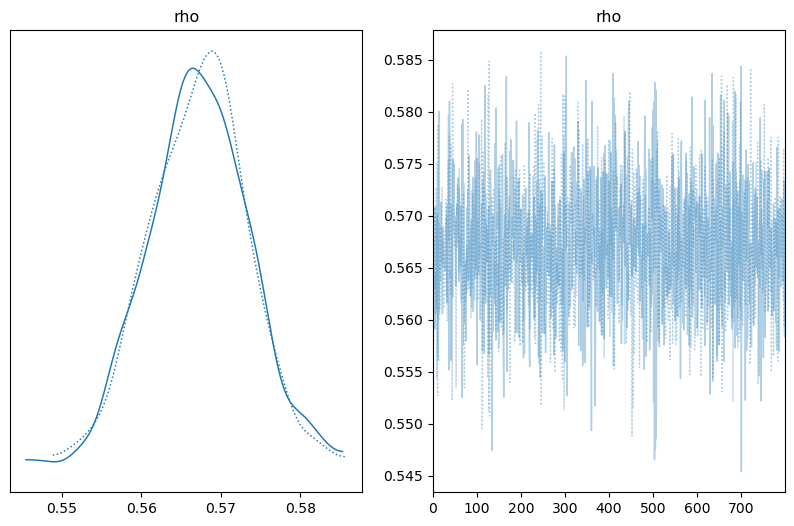

In [ ]:
az_data = az.from_cmdstanpy(fit)
az.plot_trace(az_data, var_names=["rho"], figsize=(10, 6))


array([[<Axes: title={'center': 'beta'}>,
        <Axes: title={'center': 'beta'}>]], dtype=object)

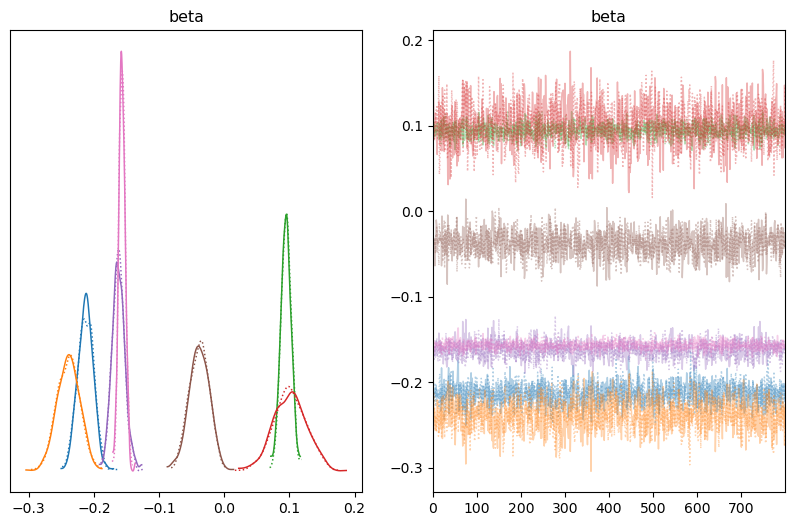

In [ ]:
az.plot_trace(az_data, var_names=["beta"], figsize=(10, 6))

array([[<Axes: title={'center': 'sigma'}>,
        <Axes: title={'center': 'sigma'}>]], dtype=object)

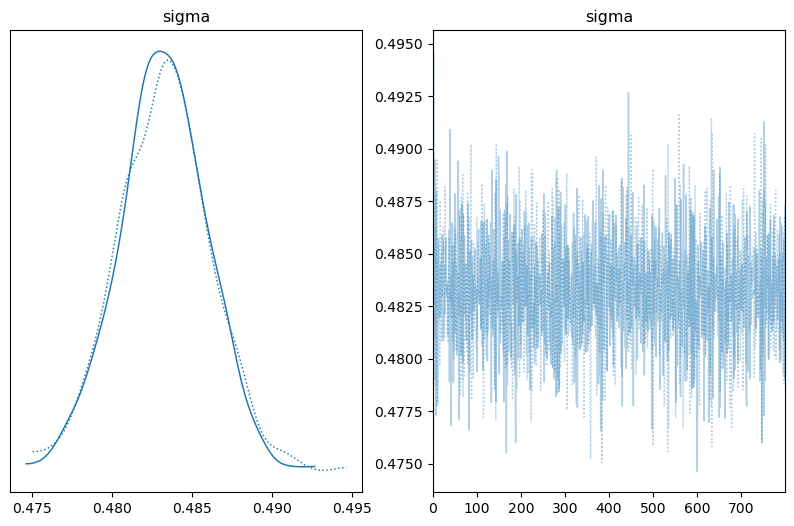

In [ ]:
az.plot_trace(az_data, var_names=["sigma"], figsize=(10, 6))

array([[<Axes: title={'center': 'w'}>, <Axes: title={'center': 'w'}>]],
      dtype=object)

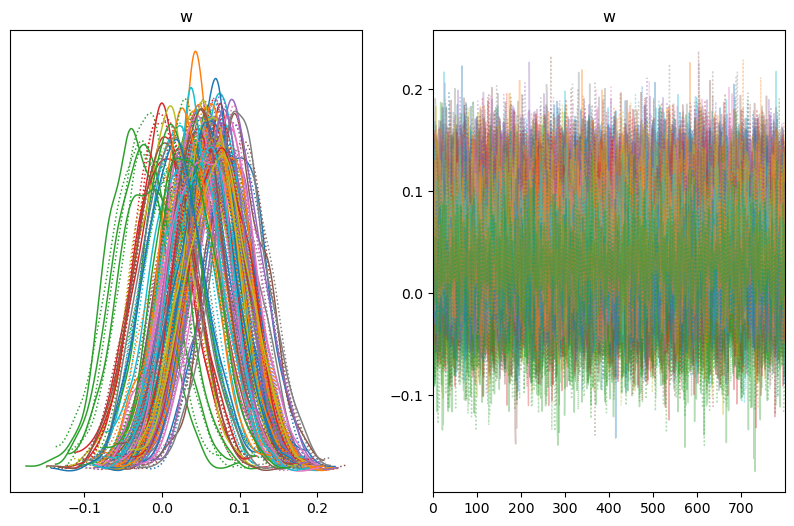

In [ ]:
az.plot_trace(az_data, var_names=["w"], figsize=(10, 6))

array([[<Axes: title={'center': 'rho_w'}>,
        <Axes: title={'center': 'rho_w'}>]], dtype=object)

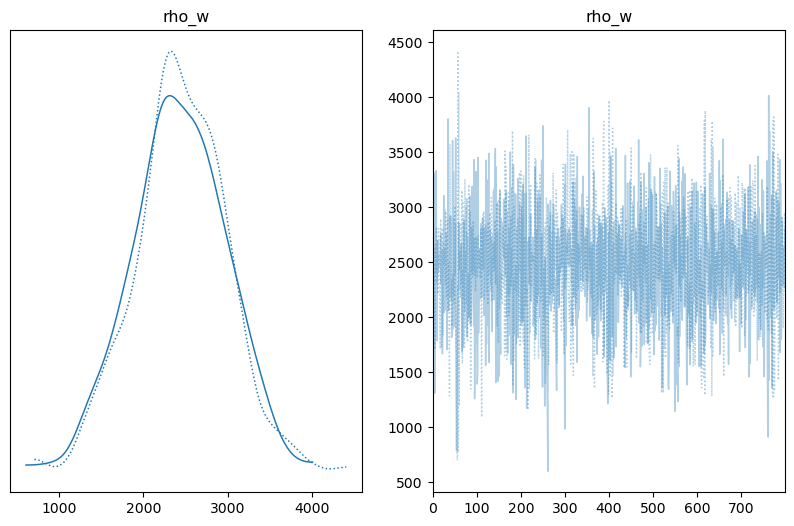

In [ ]:
az.plot_trace(az_data, var_names=["rho_w"], figsize=(10, 6))

### Credibility Intervals

Now it is time to check for the credibility interval of our betas:

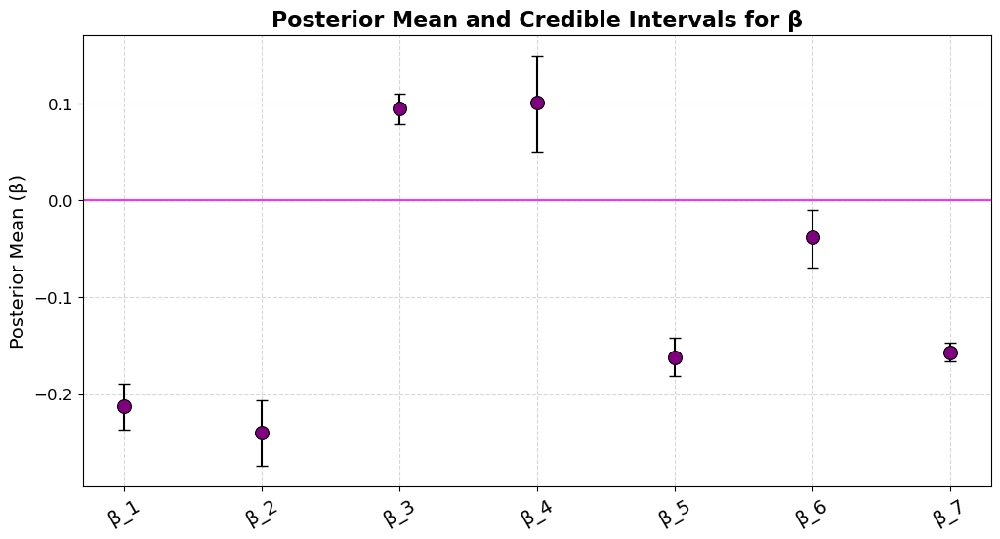

In [ ]:
beta_samples = az_data.posterior["beta"].values  # we take into consideration the beta
beta_samples = beta_samples.reshape(-1, beta_samples.shape[-1])  # Flatten across chains

# 95% of credibility intervals
mean_beta = np.mean(beta_samples, axis=0)
ci_lower = np.percentile(beta_samples, 2.5, axis=0)
ci_upper = np.percentile(beta_samples, 97.5, axis=0)

#plot code
num_betas = beta_samples.shape[1]
df_beta = pd.DataFrame({
    'Parameter': [f'β_{i+1}' for i in range(num_betas)],
    'Mean': mean_beta,
    'CI Lower': ci_lower,
    'CI Upper': ci_upper
})

plt.figure(figsize=(12, 6))
sns.scatterplot(x=df_beta['Parameter'], y=df_beta['Mean'], color="purple", s=100, edgecolor='black', zorder=3)
plt.errorbar(df_beta['Parameter'], df_beta['Mean'],
             yerr=[df_beta['Mean'] - df_beta['CI Lower'], df_beta['CI Upper'] - df_beta['Mean']],
             fmt='none', ecolor='black', capsize=4, zorder=2)
plt.axhline(y=0, color='magenta', linestyle='solid', linewidth=1.5, alpha=0.8)
plt.xticks(rotation=30, fontsize=14)
plt.yticks(fontsize=12)
plt.ylabel("Posterior Mean (β)", fontsize=14)
plt.xlabel("")
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend([], [], frameon=False)
plt.title("Posterior Mean and Credible Intervals for β", fontsize=16, fontweight='bold')

plt.show()



We can notice that none of our beta is non significative.




# Results Analysis

In this section we aim to analyze the results through graphical visualizaton.

## Causal Impact Analysis
First we look at our stations in the period of post intervention thanks to a graphical rappresentation (inspired by the one in R implemented in the pack CausalImpact) in which the three images represent respectivly:
1. The real value vs the symulated one, with the uncertainty interval of 0.05%;
2. The point impact, also with uncertainty of 0.05%;
3. The comulative impact, uncertainity of 0.05%.
As we will see the third one is the most relevant to adress the estimation of our impact.

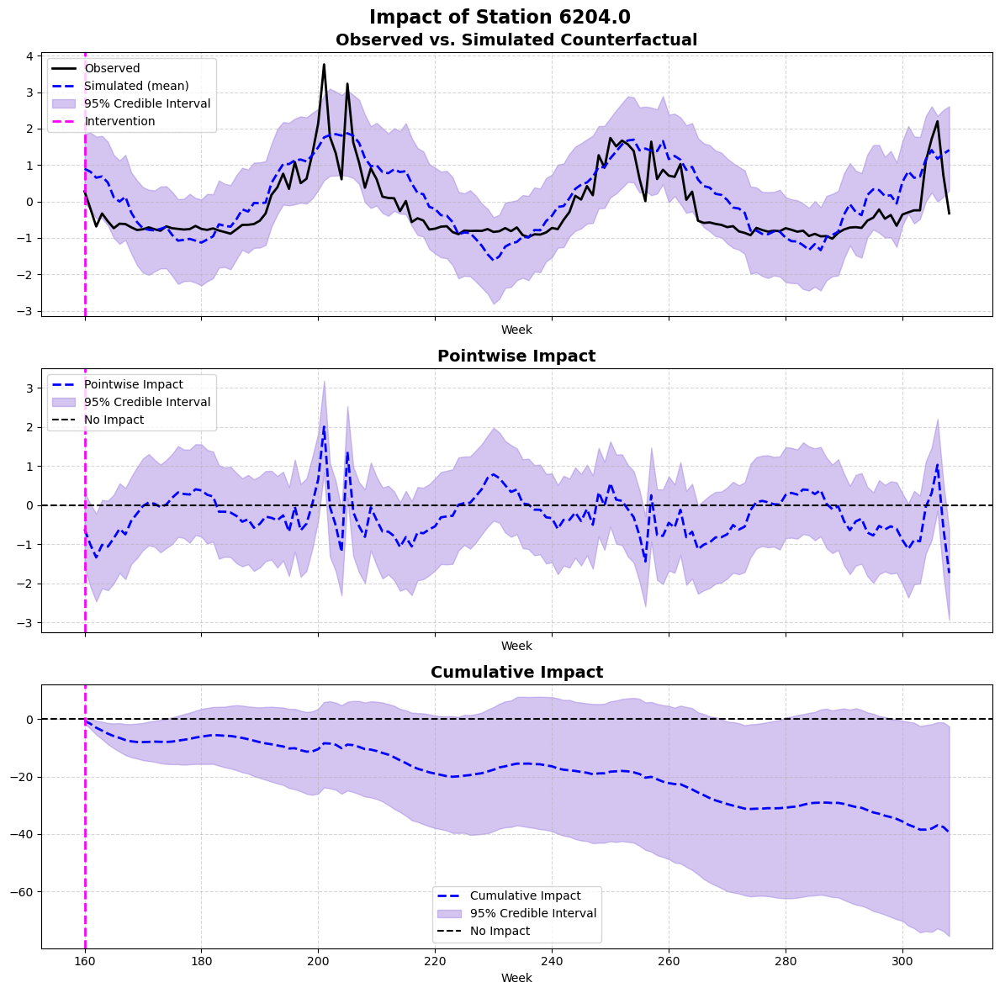

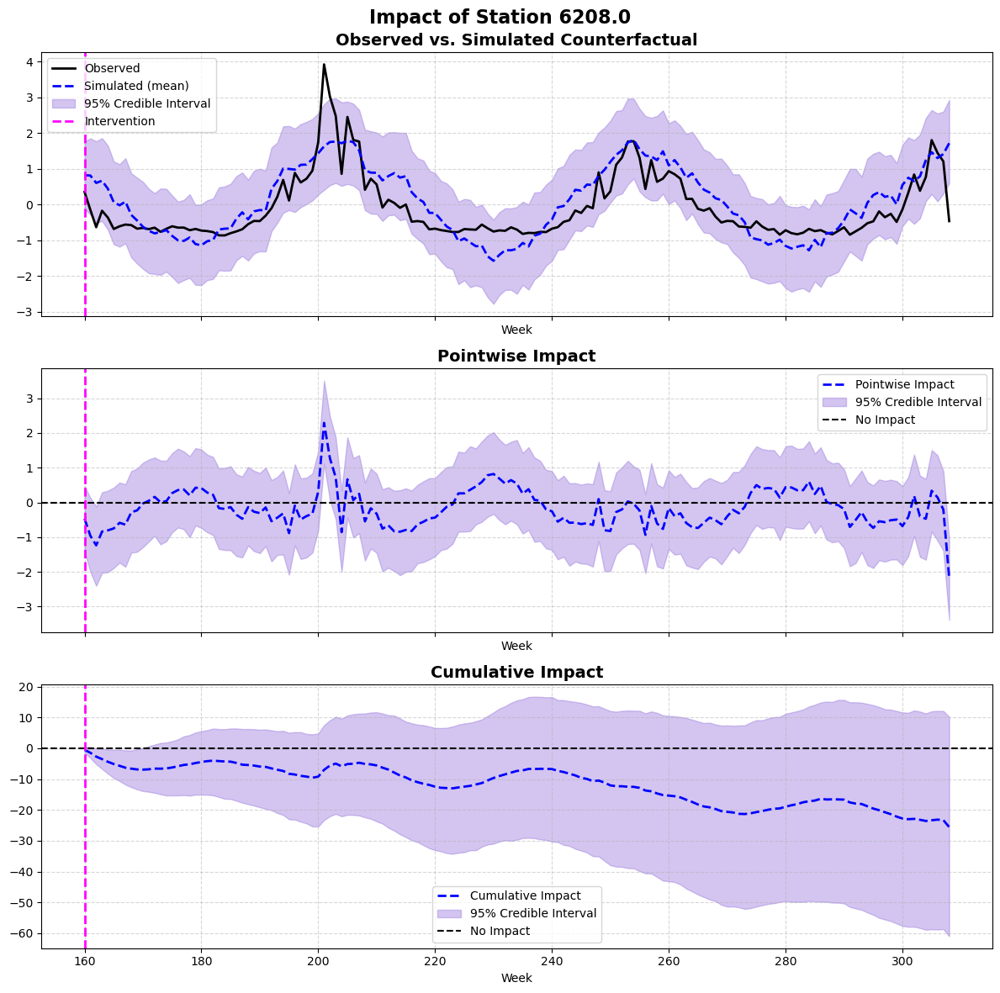

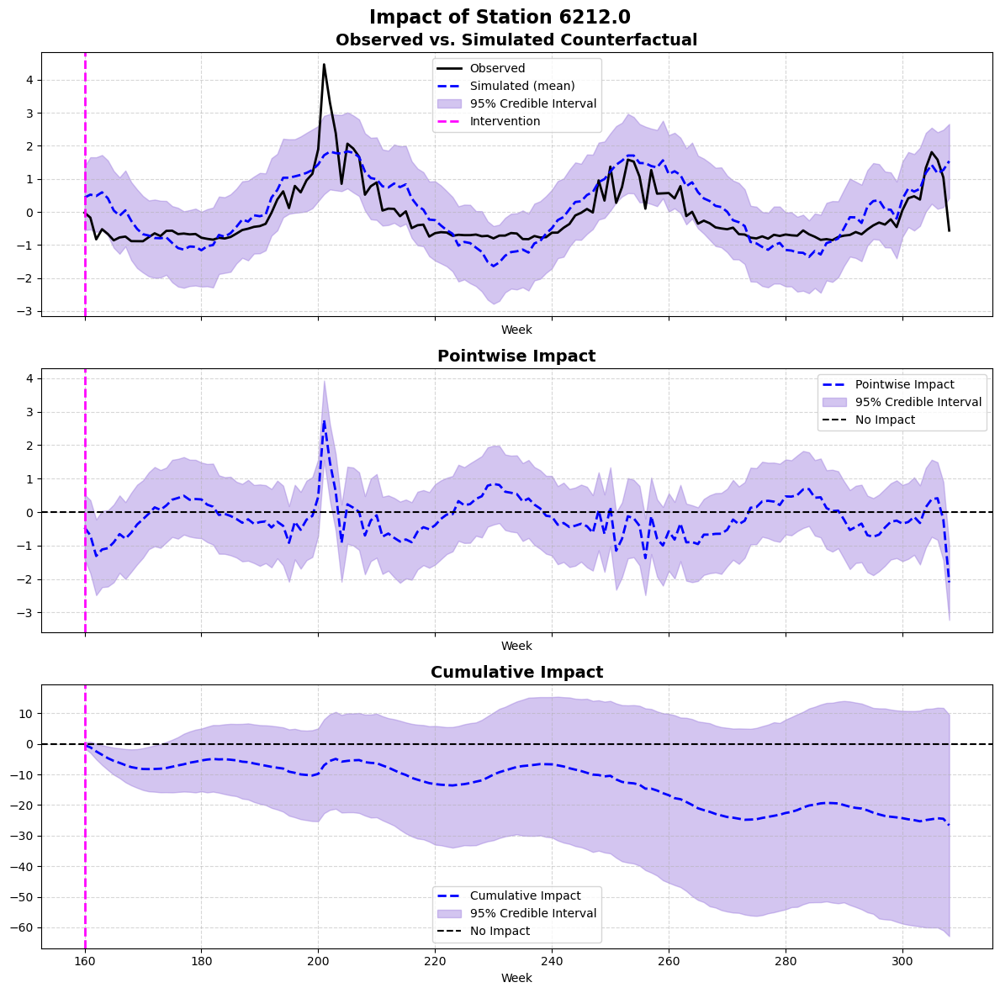

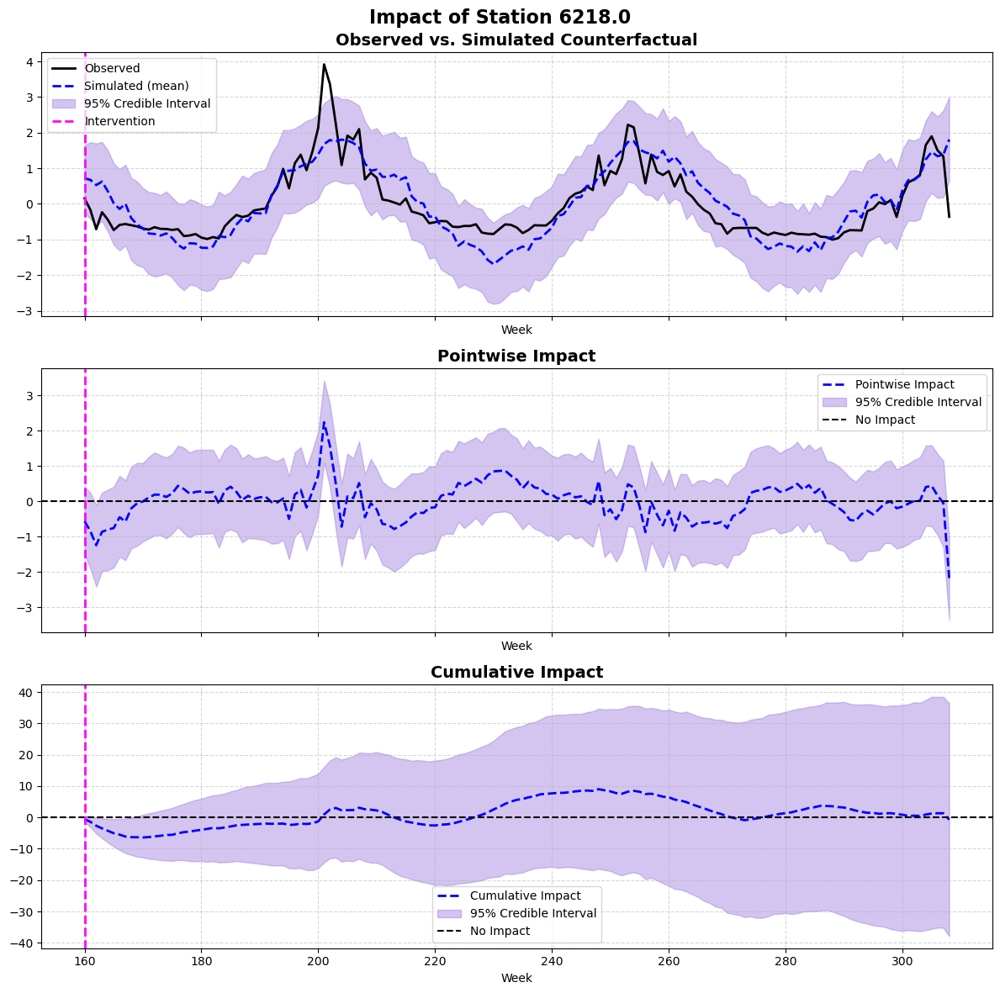

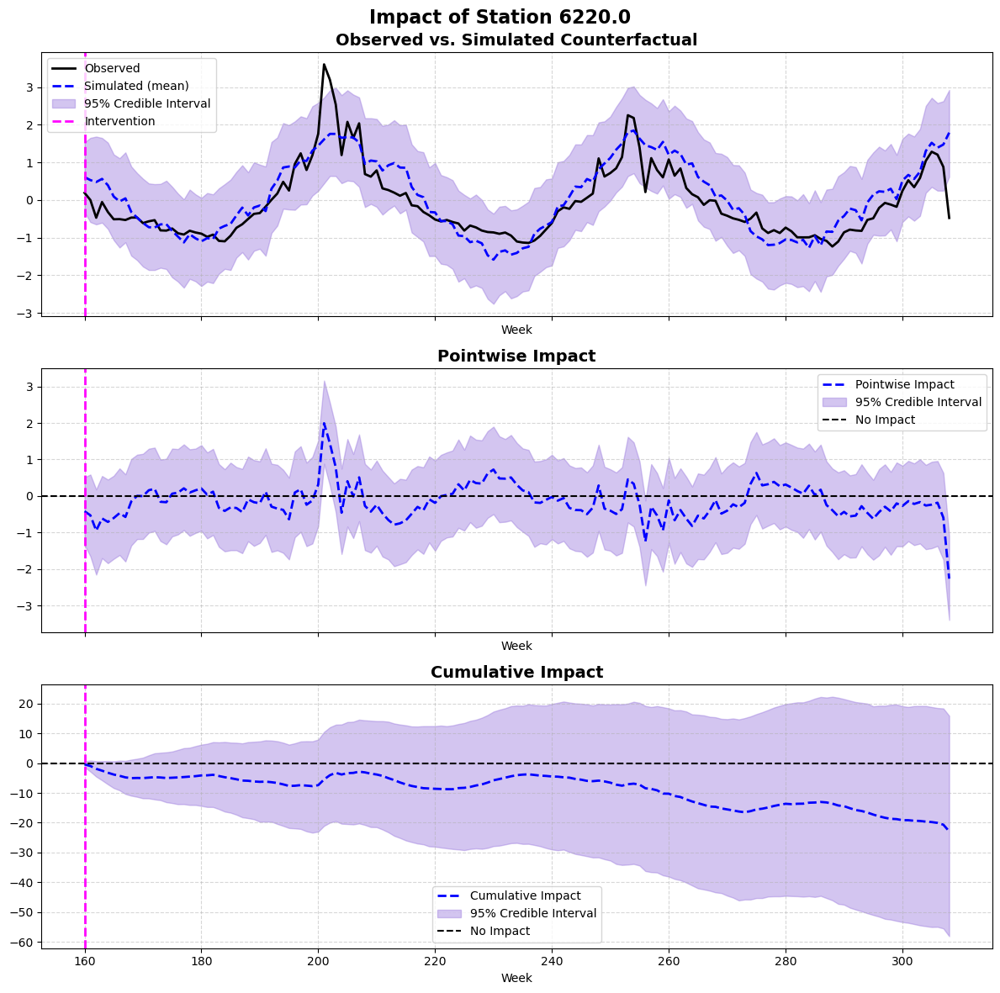

...

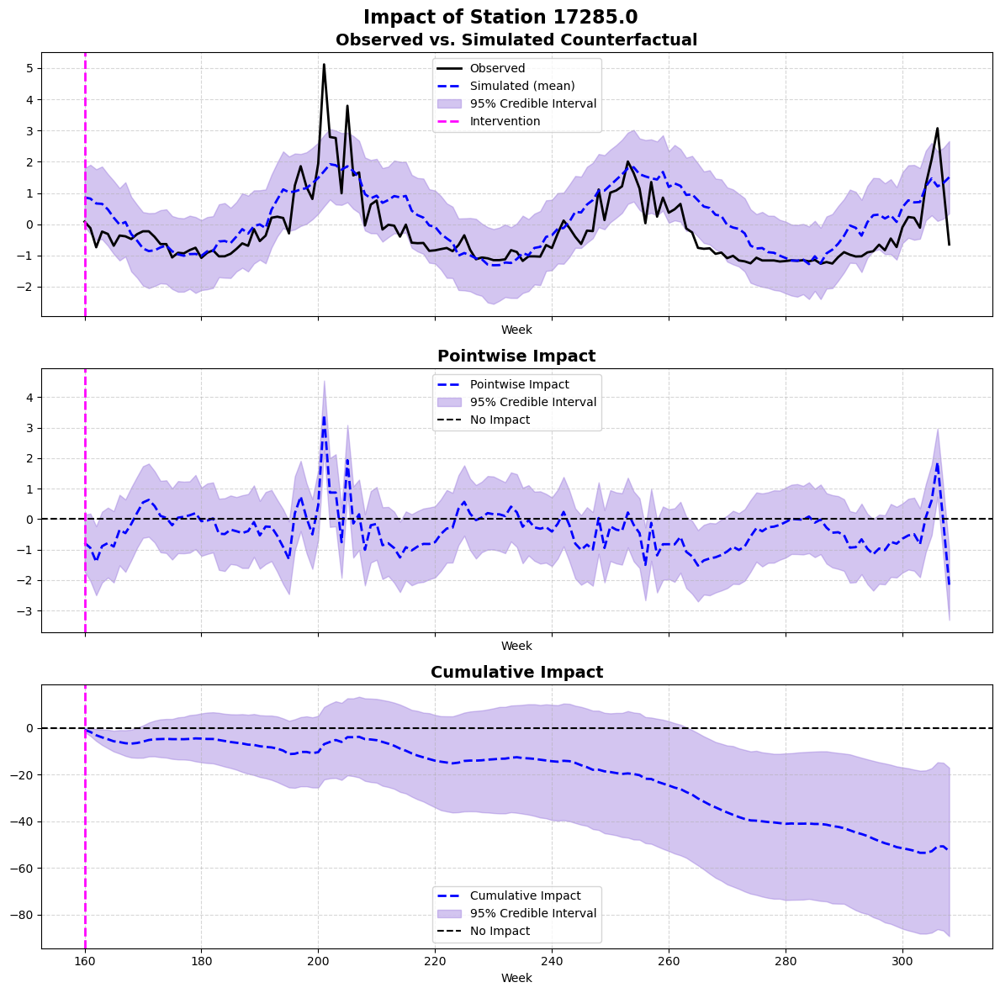

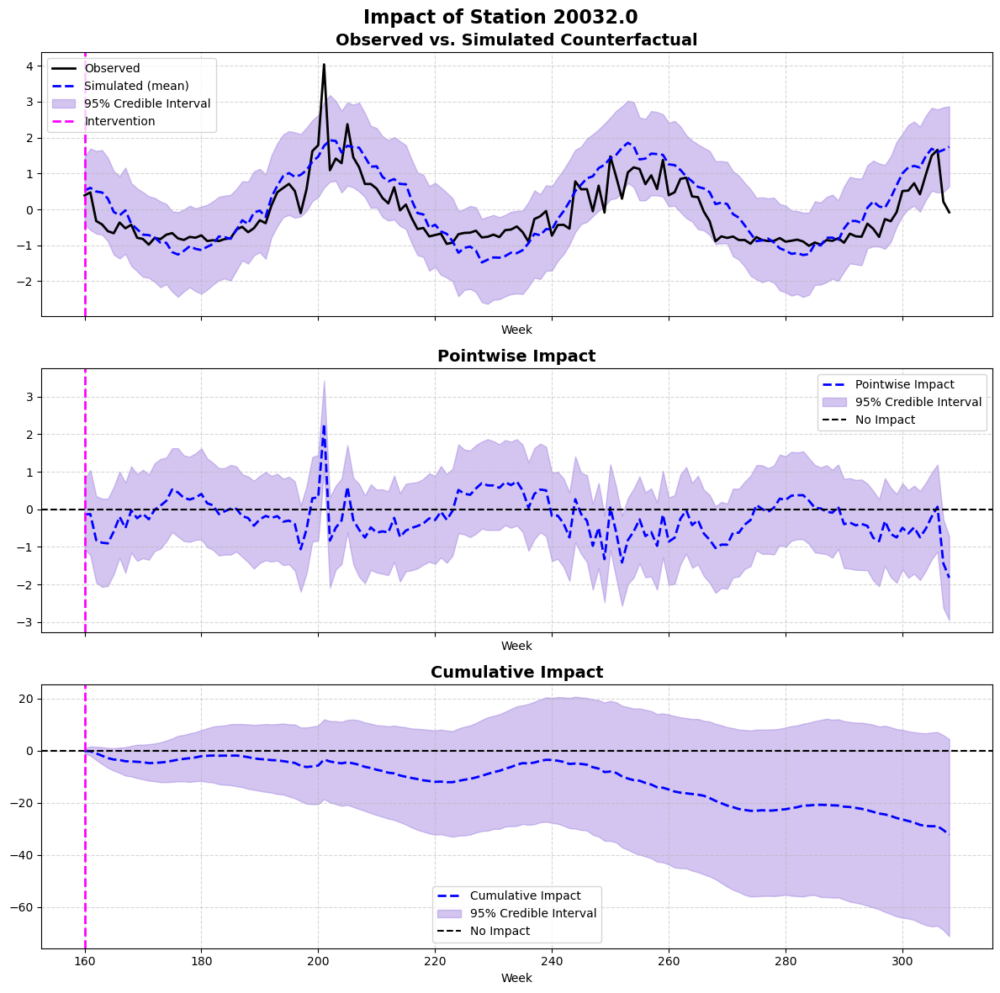

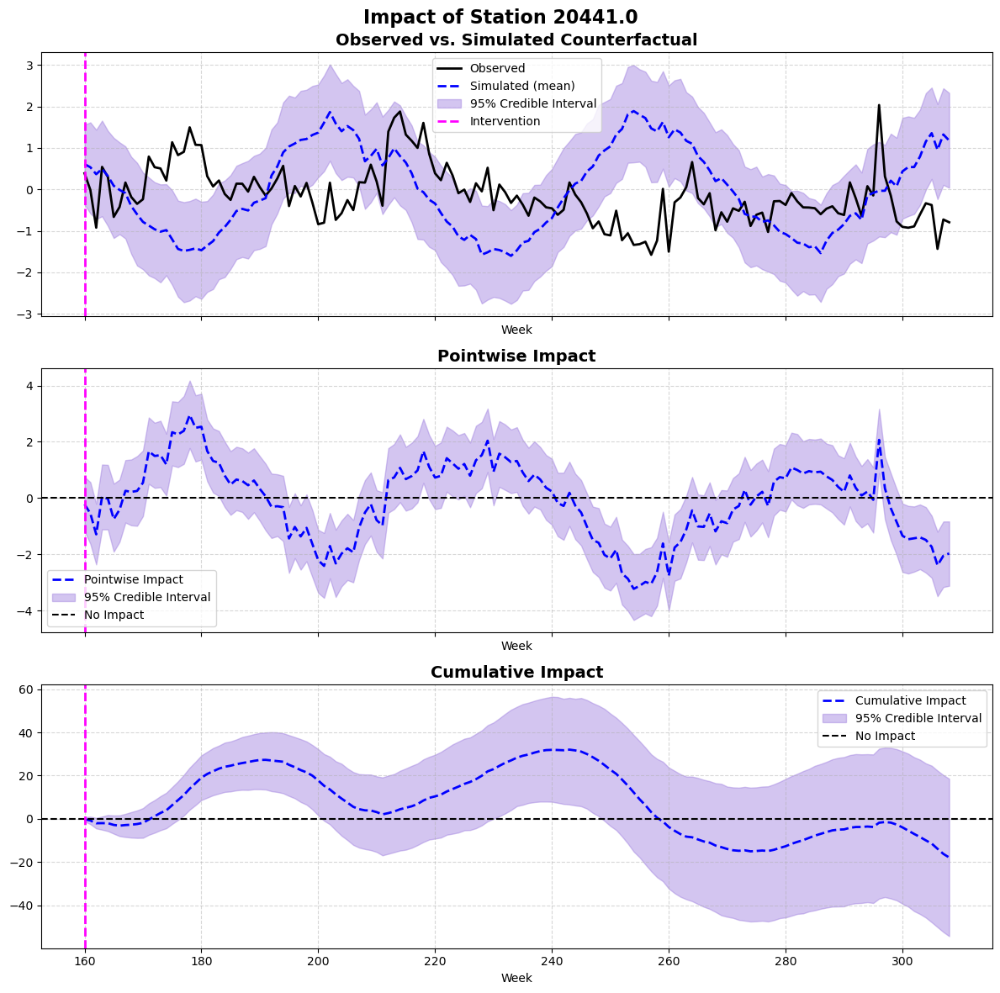

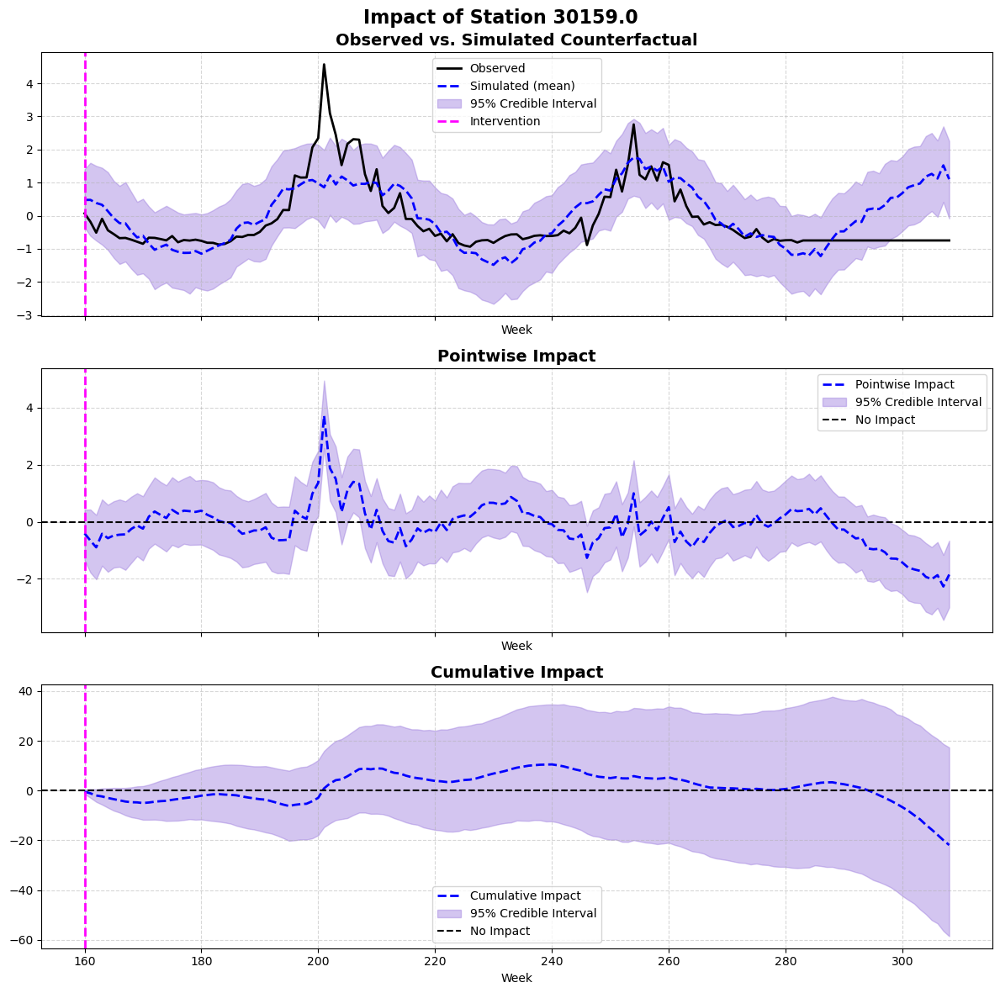

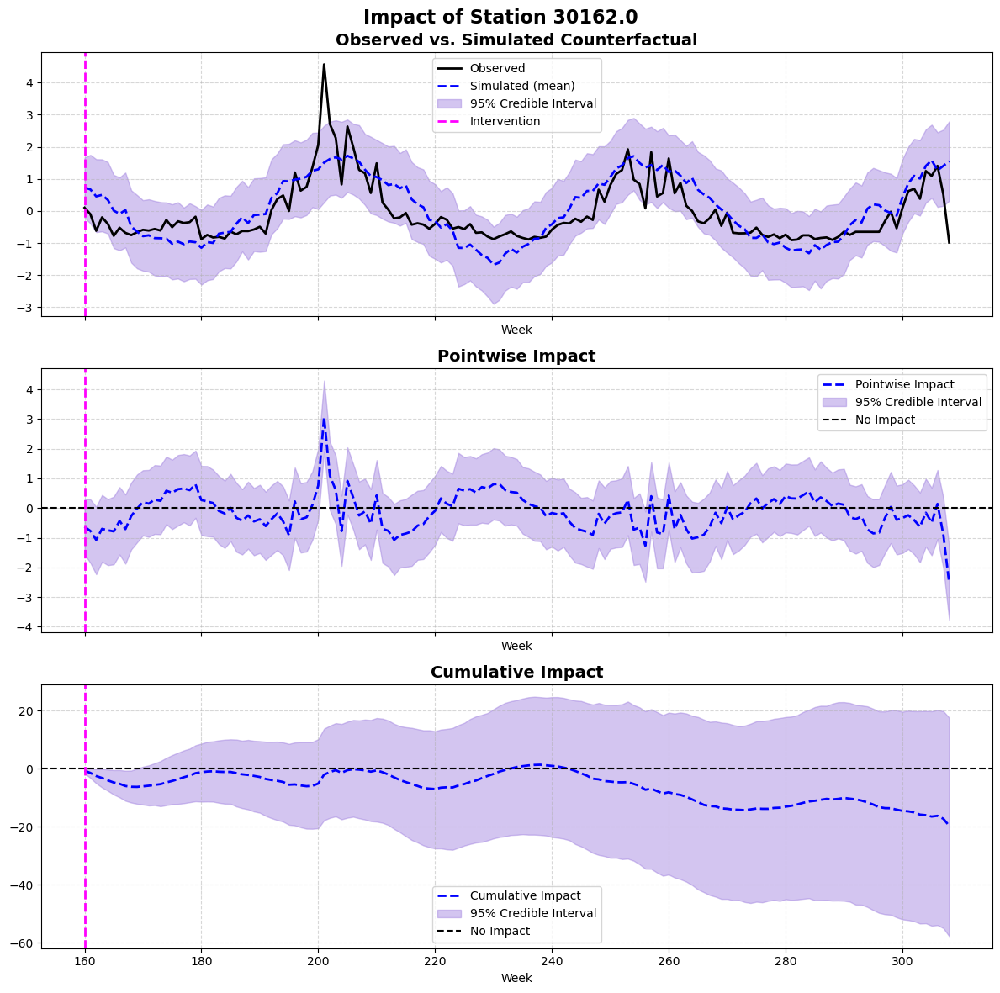

In [ ]:
# Extraction of sensor IDs
sensor_ids = y_normalized.index.tolist()

# Extraction of simulated values (post-intervention)
posterior_y_sim = fit.stan_variable("y_sim")

# Extraction of pointwise impact (Post - intervention)
posterior_point_impact = fit.stan_variable("impact")

# Computation of the cumulative impact for each station
posterior_cumulative_impact = np.cumsum(posterior_point_impact, axis=2)

# Computation of median and credible intervals for each of the previous
y_sim_median = np.median(posterior_y_sim, axis=0)
y_sim_low = np.percentile(posterior_y_sim, 2.5, axis=0)
y_sim_high = np.percentile(posterior_y_sim, 97.5, axis=0)

point_impact_median = np.median(posterior_point_impact, axis=0)
point_impact_low = np.percentile(posterior_point_impact, 2.5, axis=0)
point_impact_high = np.percentile(posterior_point_impact, 97.5, axis=0)

cumulative_impact_median = np.median(posterior_cumulative_impact, axis=0)
cumulative_impact_low = np.percentile(posterior_cumulative_impact, 2.5, axis=0)
cumulative_impact_high = np.percentile(posterior_cumulative_impact, 97.5, axis=0)

# Plot of post - intervention effects for each station
for i, sensor_id in enumerate(sensor_ids):
    fig, axes = plt.subplots(3, 1, figsize=(12, 12), sharex=True)
    fig.suptitle(f"Impact of Station {sensor_id}", fontsize=16, fontweight="bold")

    # Simulated vs Real
    axes[0].plot(range(T0, T), y_normalized.values[i, T0:T],
                 label="Observed", color="black", linewidth=2)
    axes[0].plot(range(T0, T), y_sim_median[i, :],
                 label="Simulated (mean)", color="blue", linestyle="dashed", linewidth=2)
    axes[0].fill_between(range(T0, T), y_sim_low[i, :], y_sim_high[i, :],
                         color="mediumpurple", alpha=0.4, label="95% Credible Interval")
    axes[0].axvline(x=T0, color="magenta", linestyle="--", linewidth=2, label="Intervention")
    axes[0].set_title("Observed vs. Simulated Counterfactual", fontsize=14, fontweight="bold")
    axes[0].legend()

    # Pointwise Impact
    axes[1].plot(range(T0, T), point_impact_median[i, :],
                 label="Pointwise Impact", color="blue", linestyle="dashed", linewidth=2)
    axes[1].fill_between(range(T0, T), point_impact_low[i, :], point_impact_high[i, :],
                         color="mediumpurple", alpha=0.4, label="95% Credible Interval")
    axes[1].axhline(y=0, color="black", linestyle="--", linewidth=1.5, label="No Impact")
    axes[1].axvline(x=T0, color="magenta", linestyle="--", linewidth=2)
    axes[1].set_title("Pointwise Impact", fontsize=14, fontweight="bold")
    axes[1].legend()

    # Cumulative Impact
    axes[2].plot(range(T0, T), cumulative_impact_median[i, :],
                 label="Cumulative Impact", color="blue", linestyle="dashed", linewidth=2)
    axes[2].fill_between(range(T0, T), cumulative_impact_low[i, :], cumulative_impact_high[i, :],
                         color="mediumpurple", alpha=0.4, label="95% Credible Interval")
    axes[2].axhline(y=0, color="black", linestyle="--", linewidth=1.5, label="No Impact")
    axes[2].axvline(x=T0, color="magenta", linestyle="--", linewidth=2)
    axes[2].set_title("Cumulative Impact", fontsize=14, fontweight="bold")
    axes[2].legend()

    for ax in axes:
        ax.grid(True, linestyle="--", alpha=0.5)
        ax.set_xlabel("Week")

    plt.tight_layout()
    plt.show()


## Omega Analysis
In the following paragraph we generate the map displaying the Lombardy map and for each station the value of its ω.

First we have to change the values of the coordinates from UTM to lon-lat format.
Then we extract the mean values of the ωᵢ.

In [ ]:
#!pip install pyproj #if you don't have the library uncomment it

C:\Users\david\AppData\Local\Temp\ipykernel_5148\1639779448.py:11: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat = transform(utm_proj, wgs84_proj, easting, northing)


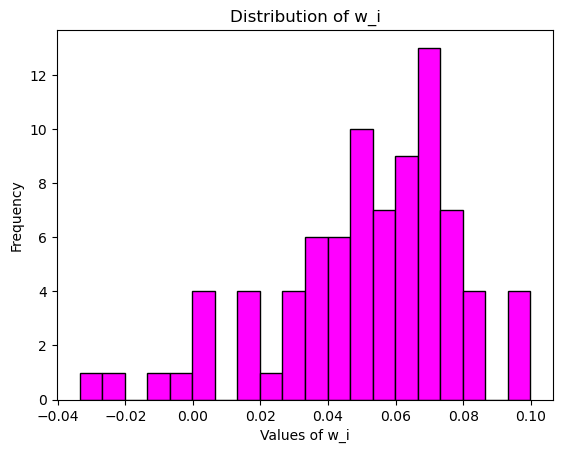

In [ ]:
from pyproj import Proj, transform
import pandas as pd

coords_temp = coords

# Conversion in long-lat
utm_proj = Proj(proj='utm', zone=32, ellps='WGS84', south=False)  # Lombardia in zone UTM 32N
wgs84_proj = Proj(proj='latlong', datum='WGS84')

def utm_to_latlon(easting, northing):
    lon, lat = transform(utm_proj, wgs84_proj, easting, northing)
    return lat, lon
coords_temp['lat'], coords_temp['lon'] = zip(*coords_temp.apply(lambda row: utm_to_latlon(row['UTM_Est'], row['Utm_Nord']), axis=1))

coords_ll = coords_temp[['lat', 'lon']].values


# Extraction of w
w_columns = [col for col in posterior.columns if col.startswith("w[")]
w_samples = posterior[w_columns]  # Filtra solo i campioni di `w`

# Menns of w for each station
w_means = w_samples.mean(axis=0).values

plt.hist(w_means, bins=20, color='magenta', edgecolor='black')
plt.title("Distribution of w_i")
plt.xlabel("Values of w_i")
plt.ylabel("Frequency")
plt.show()



In [ ]:
#colors map
mappa = folium.Map(location=[45.5, 9.5], zoom_start=8)
norm = colors.Normalize(vmin=min(w_means), vmax=max(w_means))

#Map production
def custom_colormap(w_means):
    normalized_value = norm(w_means)
    return colors.rgb2hex((normalized_value, 0, normalized_value))  # Black → Magenta

for (station_id, (lat, lon), w) in zip(sensor_ids, coords_ll, w_means):
    color = custom_colormap(w)
    folium.CircleMarker(
        location=[lat, lon],
        radius=8,
        color=color,
        fill=True,
        fill_opacity=1.0,
        fill_color=color,
        popup=f"<b>Station ID:</b> {station_id}<br><b>w_i:</b> {w:.2f}"
    ).add_to(mappa)

# legend
colormap_bar = folium.LinearColormap(
    colors=["black", "magenta"],
    vmin=-0.04, vmax=0.1,
    caption="Spatial Effect (w_i)"
)
mappa.add_child(colormap_bar)
mappa.save("mappa_stazioni.html")
mappa




In [ ]:
print(cumulative_impact_median.shape)   # Mediana
print(cumulative_impact_low.shape)  # 5%
print(cumulative_impact_high.shape)  # 95%



dff1 = pd.DataFrame(cumulative_impact_median)
dff2 = pd.DataFrame(cumulative_impact_low)
dff3 = pd.DataFrame(cumulative_impact_high)



merged_med = pd.concat([dff1, coords.reset_index(drop=True)], axis=1)
merged_low = pd.concat([dff2, coords.reset_index(drop=True)], axis=1)
merged_high = pd.concat([dff3, coords.reset_index(drop=True)], axis=1)

merged_high.to_csv('high.csv')
merged_low.to_csv('low.csv')
merged_med.to_csv('med.csv')

(83, 149)
(83, 149)
(83, 149)
